# Deep Convolutional Generative Adversarial Network
<b>Optimizer:</b> Adam <br/>
<b>Dataset:</b> Anime Face Dataset <br/>
<b>link to dataset on kaggle:</b> https://www.kaggle.com/datasets/splcher/animefacedataset

# About Dataset
This dataset has 63,632 anime faces.

# Imports

In [65]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.models as models
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
import torchmetrics
import random
import os
import gc
import PIL

from torch.utils.data import DataLoader
from tqdm import tqdm
from matplotlib.pyplot import imshow

In [2]:
# Make device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

# Reproducibility

In [3]:
RAND_CONST = 10
BATCH_SIZE = 128
IMAGE_SIZE = 64
DATA_DIR = "/kaggle/input/animefacedataset/images"

In [4]:
# Worker initialization function for data loaders (simplest approach)
def seed_worker(worker_id):
    worker_seed = (torch.initial_seed() + worker_id) % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

g_train = torch.Generator().manual_seed(RAND_CONST)

In [5]:
# Seed the RNG for all devices (both CPU and CUDA)
torch.manual_seed(RAND_CONST)
# Set python seed
random.seed(RAND_CONST)
# Set numpy seed
np.random.seed(RAND_CONST)
# Force cuDNN to deterministically select an algorithm
# *possibly at the cost of reduced performance
torch.backends.cudnn.benchmark = False
# Configure PyTorch to use deterministic algorithms
# torch.use_deterministic_algorithms(True) (involves env. variables, so not used)

# Data read

In [6]:
class GenerativeDataset(torch.utils.data.Dataset):
    def __init__(self, folder_path, transformer, save_load=None):
        self.folder_path = folder_path # path to dataset
        self.transformer = transformer # transformer applied to images
        self.image_list = self._load_image_list() # load list of all images in dataset folder
        self.images = []
        self.save_load = save_load # used to save or load processed data to some directory
        self._load_images() # read images

    def _load_image_list(self):
        # load list of all images in dataset folder
        return [f for f in os.listdir(self.folder_path) if f.endswith('.jpg') or f.endswith('.png')]

    def _load_images(self):
        if (self.save_load is None) or self.save_load=="save":
            for idx in tqdm(range(len(self.image_list))):
                image_path = os.path.join(self.folder_path, self.image_list[idx])
                image = PIL.Image.open(image_path).convert('RGB') # open image in RGB mode
                self.images.append(self.transformer(image).numpy()) # apply transformer to image

            self.images = torch.tensor(np.array(self.images)) # convert list of images to torch.tensor
            
            if self.save_load=="save": # save tensor of images
                torch.save(self.images, 'images_array.pt')
        else: # otherwise load tensor of images from save_load path
            self.images = torch.load(self.save_load)
        
    def __len__(self):
        return len(self.image_list) # return quantity of all images

    def __getitem__(self, idx):
        return self.images[idx] # return idx image
    
    def __array__(self):
        return self.images # return all images
    
    def mean(self, axis=(0, 2, 3)):
        # Calculate mean for the dataset
        return np.mean(self.__array__().numpy() / 255, axis=axis)

    def std(self, axis=(0, 2, 3)):
        # Calculate standard deviation for the dataset
        return np.std(self.__array__().numpy()  / 255, axis=axis)

In [7]:
# # Calculate mean and std of test and train sets
# traindata = GenerativeDataset(
#     folder_path=DATA_DIR,
#     transformer= transforms.Compose([
#     transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),  # Resize images to IMAGE_SIZExIMAGE_SIZE
#     transforms.ToTensor()])                       # Convert images to PyTorch tensors
# )       
# mean_trn = traindata.mean() 
# std_trn = traindata.std()

# np.save("mean_trn.npy", mean_trn)
# np.save("std_trn.npy", std_trn)

# mean_trn = np.load("/kaggle/input/dcgan_data/mean_trn.npy")
# std_trn = np.load("/kaggle/input/dcgan_data/std_trn.npy")

mean_trn = np.array([0.5, 0.5, 0.5])
std_trn = np.array([0.5, 0.5, 0.5])

# Define transformations to apply to the images
transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),  # Resize images to IMAGE_SIZExIMAGE_SIZE
    transforms.ToTensor(),                        # Convert images to PyTorch tensors
    transforms.Normalize(mean_trn, std_trn)       # Normalize
])

# # this part saves processed images in form of tensor as "images_array.pt"
# trainset = GenerativeDataset(folder_path=DATA_DIR, transformer=transform, save_load="save")

# # del traindata
# del trainset
# gc.collect()

In [8]:
# Initialize the generative dataset of 64 x 64 normalized images
trainset = GenerativeDataset(folder_path=DATA_DIR, transformer=transform,
                             save_load="/kaggle/input/dcgan_data/images_array_standart.pt")

# Create a sampler, that provides an iterable over train dataset (used in AdversaryTraining)
train_loader = torch.utils.data.DataLoader(
    trainset, batch_size=BATCH_SIZE, shuffle=True, drop_last=True, num_workers=0,
    worker_init_fn=seed_worker, generator=g_train)

# Data visualization

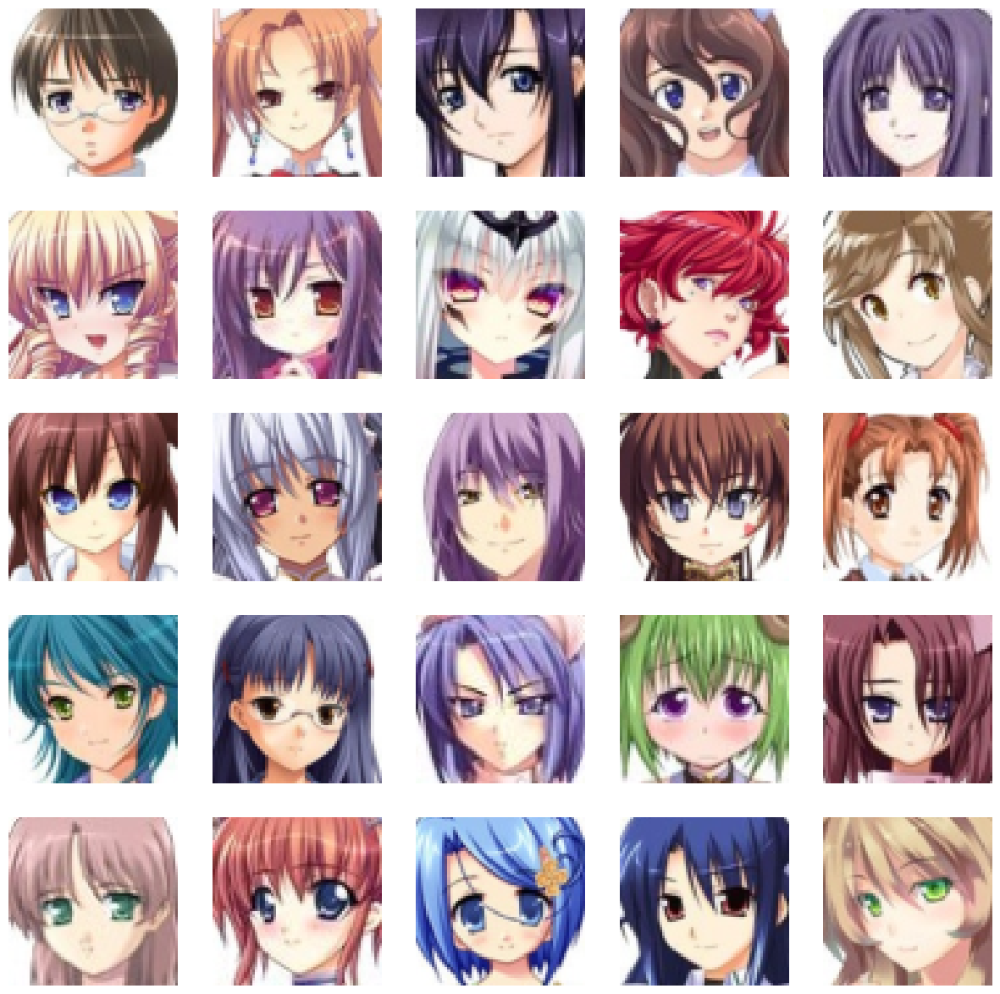

In [9]:
def imshow(img, title=None):
    img = img * std_trn[:, None, None] + mean_trn[:, None, None]
    plt.imshow(img.permute(1, 2, 0))
    if title is not None:
        plt.title(title)
        
# Get some training images
dataiter = iter(train_loader)
images = next(dataiter)

# Show images in a grid 5x5
fig = plt.figure(figsize=(15, 15))
rows, cols = 5, 5
for i in range(0, rows * cols):
    img = images[i]
    fig.add_subplot(rows, cols, i + 1)
    imshow(img)
    plt.axis(False)

In [9]:
# Custom weights initialization
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        # Conv2d and ConvTranspose2d block weights are initialized from N(0, 0.02)
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        # BatchNorm2d block weights are initialized from N(1, 0.02)  (bias==0)
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Define the generator class that generates images
class Generator(nn.Module):
    def __init__(self, latent_dim=100, ch_const=64, init_img_dim=4):
        super(Generator, self).__init__()
        
        self.latent_dim = latent_dim
        self.model = nn.Sequential(
            # input is latent_dim=100
            nn.Linear(latent_dim, ch_const * 8 * init_img_dim ** 2),
            nn.ReLU(True),
            nn.Unflatten(1, (ch_const * 8, init_img_dim, init_img_dim)),
            # state size (64*8) x 4 x 4
            nn.ConvTranspose2d(ch_const * 8, ch_const * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const * 4),
            nn.ReLU(True),
            # state size (64*4) x 8 x 8
            nn.ConvTranspose2d(ch_const * 4, ch_const * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const * 2),
            nn.ReLU(True),
            # state size (64*2) x 16 x 16
            nn.ConvTranspose2d(ch_const * 2, ch_const, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const),
            nn.ReLU(True),
            # state size (64) x 32 x 32
            nn.ConvTranspose2d(ch_const, 3, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size (3 - RGB) x (64 x 64 - spatial dimensions)
        )
    
        self.apply(weights_init) # initialize weights

    def forward(self, z):
        img = self.model(z)
        return img
    
# Define the discriminator class that identifies whether the image is fake
class Discriminator(nn.Module):
    def __init__(self, ch_const=64, end_img_dim=4):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
            # input is (3 - RGB) x (64 x 64 - spatial dimensions)
            nn.Conv2d(3, ch_const, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.25),
            # state size. (ch_const) x 32 x 32
            nn.Conv2d(ch_const, ch_const * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.25),
            # state size. (ch_const*2) x 16 x 16
            nn.Conv2d(ch_const * 2, ch_const * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.25),
            # state size. (ch_const*4) x 8 x 8
            nn.Conv2d(ch_const * 4, ch_const * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ch_const * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(0.25),
            # state size. (ch_const*8) x 4 x 4
            nn.Flatten(),
            nn.Linear(ch_const * 8 * end_img_dim**2, 1),
            nn.Sigmoid()
        )
        
        self.apply(weights_init)

    def forward(self, x):
        return self.model(x)

# Class, that creates abstraction for generator, discriminator, dataloaders, optimizers, criterion, etc., and allows to train and test GAN model as well as save checkpoint and plot graphs of loss and metrics

In [67]:
class AdversaryTraining:
    ROWS, COLS = 7, 7 # size of output images grid
    def __init__(self, generator, discriminator, gen_optimizer, disc_optimizer, criterion, dataloader, device, save_dir_prefix="", checkpoint_dir=None):
        """
        Parameters
        ----------
        criterion :
            Loss used for optimization
        checkpoint_dir : optional
            Path to directory where checkpoint state lies
        """
        
        self.disc_optimizer = disc_optimizer
        self.gen_optimizer = gen_optimizer
        self.criterion = criterion
        self.dataloader = dataloader
        self.device = device
        self.train_batches_num = len(train_loader)
        self.generator = generator
        self.discriminator = discriminator
        self.control_input = torch.randn(AdversaryTraining.ROWS*AdversaryTraining.COLS,
                                        self.generator.latent_dim, device=device)
        
        # Load training model from checkpoint
        if checkpoint_dir is not None:
            checkpoint = torch.load(checkpoint_dir)
            self.start_epoch = checkpoint['current_epoch'] + 1
            print(f"Loading AdversaryTraining model from checkpoint trained for {self.start_epoch} epochs...")

            self.generator.load_state_dict(checkpoint['generator_param'])
            self.discriminator.load_state_dict(checkpoint['discriminator_param'])
            self.disc_optimizer.load_state_dict(checkpoint['disc_optimizer_state'])
            self.gen_optimizer.load_state_dict(checkpoint['gen_optimizer_state'])
            self.best_accuracy = checkpoint['best_accuracy']
            
            # Load loss and accuracy arrays
            self.discriminator_loss_arr = checkpoint['discriminator_loss_arr']
            self.generator_loss_arr = checkpoint['generator_loss_arr']
            self.discriminator_accuracy_arr = checkpoint['discriminator_accuracy_arr']
            self.generator_accuracy_arr = checkpoint['generator_accurac_arr']
            
            # Load environment state
            torch.set_rng_state(checkpoint['rng_state'])
            torch.cuda.set_rng_state(checkpoint['cuda_rng_state'])
            np.random.set_state(checkpoint['np_random_state'])
            random.setstate(checkpoint['random_state'])
            
        # Create blank training model
        else:
            print("Creating AdversaryTraining model from scratch...")
            self.start_epoch = 0
            self.best_accuracy = 0
            # Create required arrays to store loss and accuracy
            self.discriminator_loss_arr = []
            self.generator_loss_arr = []
            self.discriminator_accuracy_arr = []
            self.generator_accuracy_arr = []

        print(f"Model successfully created! Current start_epoch={self.start_epoch + 1}")
        self.checkpoint_directory =\
            f'{type(self.generator).__name__}_{type(self.discriminator).__name__}_Adversary_checkpoints'
        if save_dir_prefix != "":
            self.checkpoint_directory += "_" + save_dir_prefix
        
    def train_validate_cycle(self, epochs, cycle_epoch=1, cycle_batch=400):
        """
        Parameters
        ----------
        epochs :
            Number of training and validation cycle epochs
        cycle_epoch : optional
            The number that determines after which amount of epochs information will be displayed
        cycle_batch :  optional
            The number that determines after which amount of batches in each epoch information will be displayed
        """
        # Define flag for info display
        print_ind = False
        
        ##### Training for epochs #####
        # Create training and validation loop
        print(f"Training model for {epochs} epochs from {self.start_epoch + 1} to"
              f" {self.start_epoch + epochs}.")
        for epoch in range(self.start_epoch, self.start_epoch + epochs):
            global_print = (epoch + 1) % cycle_epoch == 0
            if global_print:
                print(f"Current epoch: {epoch + 1}/{epochs}\n-------")
                print(f"Current generated images:")
                self.display_control_output() # display current generated images
                print_ind = True

            ##### Training #####
            discriminator_loss = generator_loss = discriminator_accuracy = generator_accuracy = 0
            # Set network to train mode
            self.generator.train()
            self.discriminator.train()

            # Add a loop through training batches
            for batch_num, real_images in tqdm(enumerate(self.dataloader)):
               # Send to cuda
                real_images = real_images.to(self.device) 

                # Adversarial ground truths
                valid = torch.ones(BATCH_SIZE, 1, device=self.device)
                fake = torch.zeros(BATCH_SIZE, 1, device=self.device)

                # ---------------------
                #  Train Discriminator
                # ---------------------

                self.discriminator.zero_grad()

                # Sample noise as generator input
                z = torch.randn(BATCH_SIZE, self.generator.latent_dim, device=self.device)

                # Generate a batch of images
                fake_images = self.generator(z)

                # Measure discriminator's ability 
                # to classify real and fake images
                disc_real_output = self.discriminator(real_images)
                real_loss = self.criterion(disc_real_output, valid)
                disc_fake_output = self.discriminator(fake_images)
                fake_loss = self.criterion(disc_fake_output, fake)
                disc_loss = (real_loss + fake_loss)
                disc_accuracy = torch.cat([disc_fake_output < 0.5, 
                                    disc_real_output > 0.5]).float().mean().item()
                
                # Backward pass and optimize
                disc_loss.backward()
                self.disc_optimizer.step()

                # -----------------
                #  Train Generator
                # -----------------

                self.gen_optimizer.zero_grad()
                
                # Generate a batch of images
                fake_images = self.generator(z)

                # Measure generator's ability 
                # generate real-looking images
                disk_fake_output = self.discriminator(fake_images)
                gen_loss = adversarial_loss(disk_fake_output, valid)
                gen_accuracy = (disc_fake_output > 0.5).float().mean().item()

                # Backward pass and optimize
                gen_loss.backward()
                self.gen_optimizer.step()
 
                # Accumulatively add up the loss and accuracy per epoch 
                discriminator_loss += disc_loss
                generator_loss += gen_loss
                discriminator_accuracy += disc_accuracy
                generator_accuracy += gen_accuracy

                # Print out how many samples have been seen
                # Output loss and accuracy each cycle batches (cycle*batch samples)
                if (batch_num + 1) % cycle_batch == 0 and batch_num != 0 and print_ind:
                    print(f"Looked at {batch_num * BATCH_SIZE} samples")
                    print(f"Current generator loss for batch: {gen_loss}")
                    print(f"Current generator accuracy for batch: {gen_accuracy}")
                    print(f"Current discriminator loss for batch: {disc_loss}")
                    print(f"Current discriminator accuracy for batch: {disc_accuracy}")
                    
                # Clearing memory
                del real_images
                del fake_images
                del disc_real_output
                del disc_fake_output
                del valid
                del fake
                del z
            ##### Training end #####

            # Save average (throughout the epoch) loss and accuracy
            self.generator_loss_arr.append(generator_loss.item() / self.train_batches_num)
            self.discriminator_loss_arr.append(discriminator_loss.item() / self.train_batches_num)
            self.generator_accuracy_arr.append(generator_accuracy / self.train_batches_num)
            self.discriminator_accuracy_arr.append(discriminator_accuracy / self.train_batches_num)

            # Check if length of arrays is appropriate
            assert len(self.generator_loss_arr)==len(self.discriminator_loss_arr)\
                ==len(self.generator_accuracy_arr)==len(self.discriminator_accuracy_arr)
            assert epoch + 1 == len(self.generator_loss_arr)

            gl = self.generator_loss_arr[epoch]
            dl = self.discriminator_loss_arr[epoch]
            ga = self.generator_accuracy_arr[epoch]
            da = self.discriminator_accuracy_arr[epoch]
            ma = (ga + da) / 2

            if global_print:
                # Print out average loss and accuracy of this epoch each cycle_epoch
                print(f"\nAverage generator loss: {gl:.5f}\n"
                      f"Average discriminator loss: {dl:.5f}\n"
                      f"Generator accuracy: {ga:.5f}\n"
                      f"Discriminator accuracy: {da:.5f}\n"
                      f"Mean of the two accuracies: {ma:.5f}\n")
                print_ind = False

            # Save checkpoint in case of better mean accuracy
            if self.best_accuracy < ma:
                if global_print:
                    print(f'\nSaving {epoch+1}/{epochs} status:\'best\' checkpoint, '
                          f'current mean accuracy: {ma:.5f} is '
                          f'better than previous best result: {self.best_accuracy:.5f}')
                self.best_accuracy = ma
                self.checkpoint(epoch, 'best', global_print)
            else:
                if global_print:
                    print(f'\nSaving {epoch+1}/{epochs} status:\'last\' checkpoint, '
                          f'current mean accuracy: {ma:.5f}')
                self.checkpoint(epoch, 'last', global_print)
                    
            # Garbage collection     
            gc.collect()
            torch.cuda.empty_cache()
        ##### Training for epochs END #####
        self.start_epoch += epochs # Save current epoch to start new training from it
    

    def checkpoint(self, current_epoch, status, print_flag=True):
        """ Save current_epoch checkpoint """
        state = {
            'generator_param': self.generator.state_dict(),
            'discriminator_param': self.discriminator.state_dict(),
            'disc_optimizer_state': self.disc_optimizer.state_dict(),
            'gen_optimizer_state': self.gen_optimizer.state_dict(),
            'current_epoch': current_epoch,
            'best_accuracy': self.best_accuracy,
            'discriminator_accuracy_arr': self.discriminator_accuracy_arr,
            'generator_accurac_arr': self.generator_accuracy_arr,
            'discriminator_loss_arr': self.discriminator_loss_arr,
            'generator_loss_arr': self.generator_loss_arr,
            'rng_state': torch.get_rng_state(),
            'cuda_rng_state':torch.cuda.get_rng_state(),
            'np_random_state': np.random.get_state(), 
            'random_state': random.getstate()
        }
        
        if not os.path.isdir(self.checkpoint_directory):
            os.mkdir(self.checkpoint_directory)
            
        torch.save(state, './'+ self.checkpoint_directory +\
                   f'/{status}_cpt')
        if print_flag:
            print(f'Successfully saved epoch {current_epoch + 1} status:{status} checkpoint!\n')


    def plot_loss_acc(self):
        """
        Displays loss and accuracy plots.
        Works with latest epochs, train and val loss and val accuracy value and arrays respectively.
        """
        # Check if length of arrays is appropriate
        assert len(self.generator_loss_arr)==len(self.discriminator_loss_arr)\
            ==len(self.generator_accuracy_arr)==len(self.discriminator_accuracy_arr)
        
        plt.figure(figsize = (15, 5))
        epoch_arr = np.arange(1, len(self.generator_loss_arr) + 1)
        plt.subplot(121)
        plt.plot(epoch_arr, self.generator_loss_arr, 'red', label='Average generator loss')
        plt.plot(epoch_arr, self.discriminator_loss_arr,'blue', label='Average discriminator loss')
        plt.title("Loss plots")
        plt.legend()
        plt.xlabel("Epoch number")
        plt.ylabel("Loss value")
        plt.subplot(122)
        plt.plot(epoch_arr, self.generator_accuracy_arr, 'red', label='Average generator accuracy')
        plt.plot(epoch_arr, self.discriminator_accuracy_arr,'blue', label='Average discriminator accuracy')
        plt.plot(epoch_arr, (np.array(self.generator_accuracy_arr)+\
                             np.array(self.discriminator_accuracy_arr))/2,'yellow',
                 label='Combined mean accuracy')
        plt.title("Accuracy plots")
        plt.legend()
        plt.xlabel("Epoch number")
        plt.ylabel("Accuracy value")
        plt.show()

    def display_control_output(self):
        """
        Generates control output
        """
        generated_images = self.generator(self.control_input).detach().to("cpu")

        # Show images and labels in a grid ROWS x COLS
        fig = plt.figure(figsize=(10, 10))
 
        for i in range(0, AdversaryTraining.ROWS*AdversaryTraining.COLS):
            img = generated_images[i]
            fig.add_subplot(AdversaryTraining.ROWS, AdversaryTraining.COLS, i + 1)
            plt.imshow(img.permute(1,2,0))
            plt.axis(False)
            
        plt.show()

# Network training

In [12]:
LR = 0.0002 # learning rate
BETA1 = 0.5
BETA2 = 0.999

# Initialize the generator and discriminator
generator = Generator().to(device)
discriminator = Discriminator().to(device)
 
# Loss function
adversarial_loss = nn.BCELoss()
 
# Optimizers
optimizer_G = optim.Adam(generator.parameters()\
                         , lr=LR, betas=(BETA1, BETA2))
optimizer_D = optim.Adam(discriminator.parameters()\
                         , lr=LR, betas=(BETA1, BETA2))

# Create Training model
GAN = AdversaryTraining(generator, discriminator, optimizer_G, optimizer_D, adversarial_loss,
                       train_loader, device)

Creating AdversaryTraining model from scratch...

Model successfully created! Current start_epoch=1


Training model for 50 epochs from 1 to 50.


496it [00:49, 10.08it/s]

496it [00:43, 11.34it/s]


Current epoch: 3/50

-------

Current generated images:


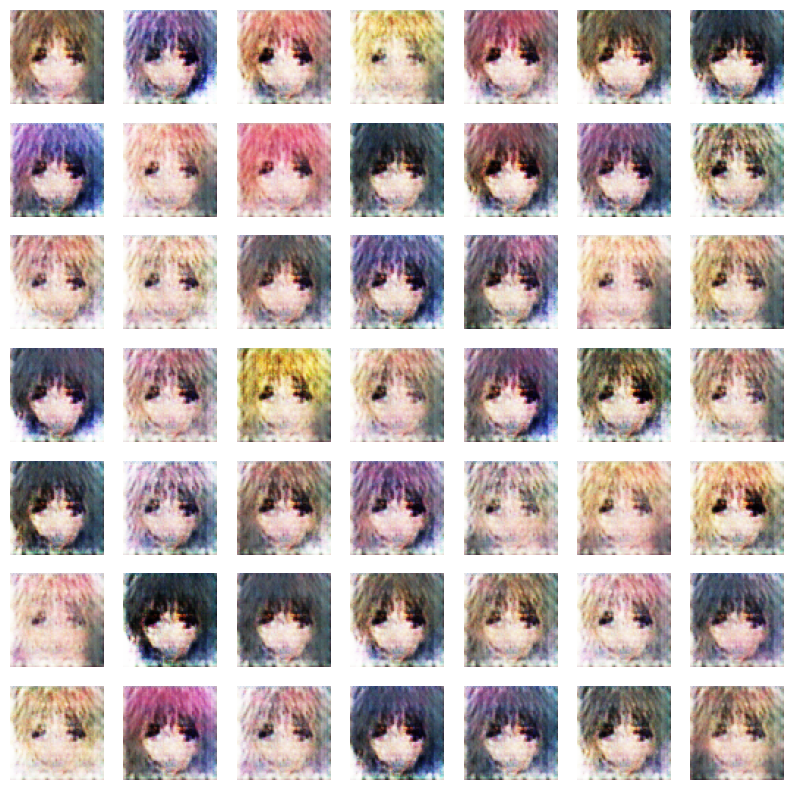

402it [00:35, 11.35it/s]

Looked at 51072 samples

Current generator loss for batch: 5.602490425109863

Current generator accuracy for batch: 0.125

Current discriminator loss for batch: 0.45158055424690247

Current discriminator accuracy for batch: 0.90625


496it [00:43, 11.36it/s]




Average generator loss: 5.04722

Average discriminator loss: 0.56490

Generator accuracy: 0.10559

Discriminator accuracy: 0.88555

Mean of the two accuracies: 0.49557





Saving 3/50 status:'best' checkpoint, current mean accuracy: 0.49557 is better than previous best result: 0.49467

Successfully saved epoch 3 status:best checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.36it/s]


Current epoch: 6/50

-------

Current generated images:


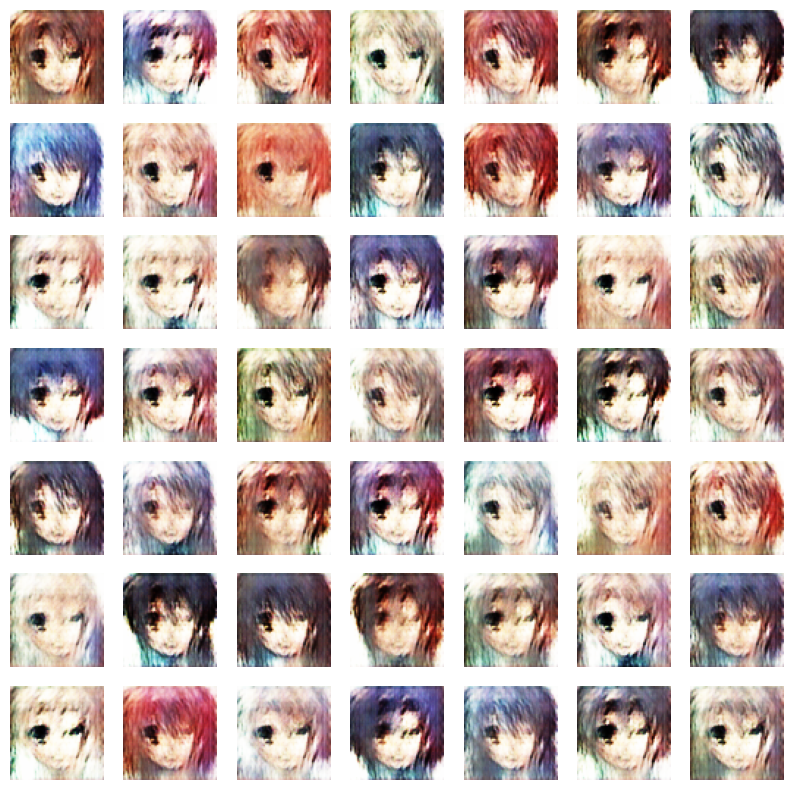

401it [00:35, 11.26it/s]

Looked at 51072 samples

Current generator loss for batch: 4.343561172485352

Current generator accuracy for batch: 0.03125

Current discriminator loss for batch: 0.4239842891693115

Current discriminator accuracy for batch: 0.91796875


496it [00:43, 11.34it/s]




Average generator loss: 5.57797

Average discriminator loss: 0.43370

Generator accuracy: 0.07375

Discriminator accuracy: 0.91670

Mean of the two accuracies: 0.49522





Saving 6/50 status:'last' checkpoint, current mean accuracy: 0.49522

Successfully saved epoch 6 status:last checkpoint!




496it [00:43, 11.36it/s]

496it [00:43, 11.36it/s]


Current epoch: 9/50

-------

Current generated images:


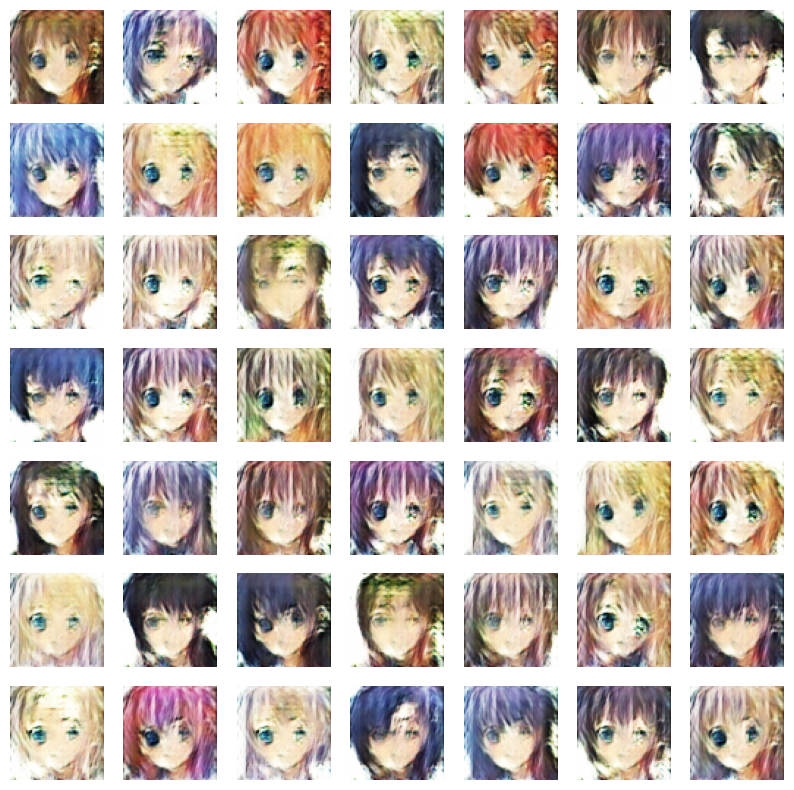

401it [00:35, 11.26it/s]

Looked at 51072 samples

Current generator loss for batch: 4.480050086975098

Current generator accuracy for batch: 0.015625

Current discriminator loss for batch: 0.23111429810523987

Current discriminator accuracy for batch: 0.9765625


496it [00:43, 11.31it/s]




Average generator loss: 5.61604

Average discriminator loss: 0.42464

Generator accuracy: 0.07842

Discriminator accuracy: 0.91641

Mean of the two accuracies: 0.49742





Saving 9/50 status:'best' checkpoint, current mean accuracy: 0.49742 is better than previous best result: 0.49640

Successfully saved epoch 9 status:best checkpoint!




496it [00:43, 11.36it/s]

496it [00:43, 11.32it/s]


Current epoch: 12/50

-------

Current generated images:


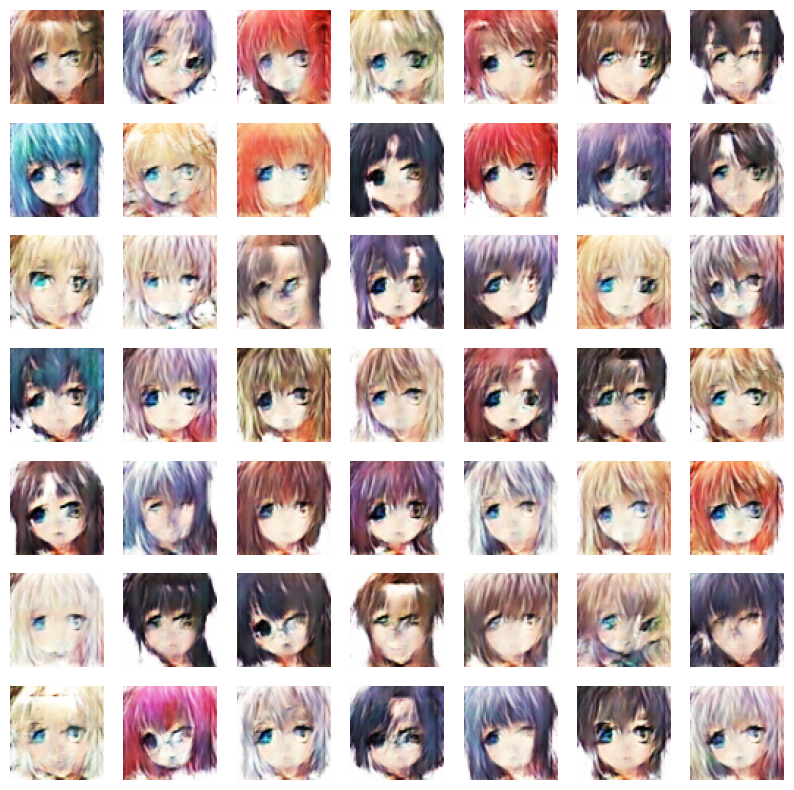

402it [00:35, 11.42it/s]

Looked at 51072 samples

Current generator loss for batch: 8.634231567382812

Current generator accuracy for batch: 0.328125

Current discriminator loss for batch: 0.6674302816390991

Current discriminator accuracy for batch: 0.8359375


496it [00:43, 11.36it/s]




Average generator loss: 5.15354

Average discriminator loss: 0.48905

Generator accuracy: 0.09310

Discriminator accuracy: 0.90220

Mean of the two accuracies: 0.49765





Saving 12/50 status:'last' checkpoint, current mean accuracy: 0.49765

Successfully saved epoch 12 status:last checkpoint!




496it [00:43, 11.32it/s]

496it [00:43, 11.33it/s]


Current epoch: 15/50

-------

Current generated images:


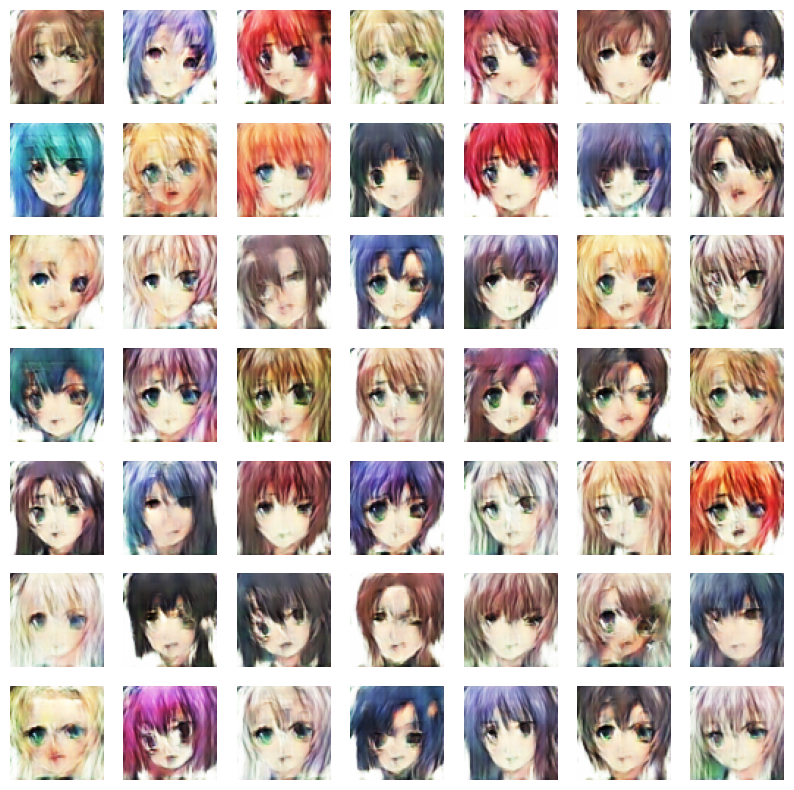

402it [00:35, 11.42it/s]

Looked at 51072 samples

Current generator loss for batch: 2.9012210369110107

Current generator accuracy for batch: 0.0078125

Current discriminator loss for batch: 0.42515403032302856

Current discriminator accuracy for batch: 0.8984375


496it [00:43, 11.36it/s]




Average generator loss: 4.67256

Average discriminator loss: 0.48918

Generator accuracy: 0.09388

Discriminator accuracy: 0.90276

Mean of the two accuracies: 0.49832





Saving 15/50 status:'best' checkpoint, current mean accuracy: 0.49832 is better than previous best result: 0.49829

Successfully saved epoch 15 status:best checkpoint!




496it [00:43, 11.32it/s]

496it [00:43, 11.37it/s]


Current epoch: 18/50

-------

Current generated images:


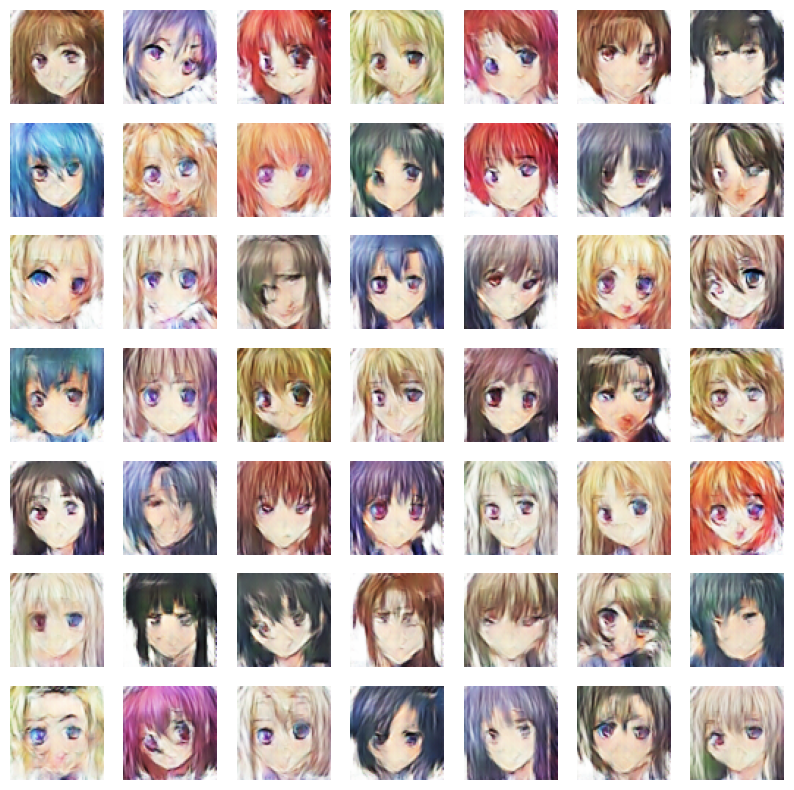

402it [00:35, 11.35it/s]

Looked at 51072 samples

Current generator loss for batch: 3.8512909412384033

Current generator accuracy for batch: 0.0

Current discriminator loss for batch: 0.41822442412376404

Current discriminator accuracy for batch: 0.9140625


496it [00:43, 11.36it/s]




Average generator loss: 4.47320

Average discriminator loss: 0.48347

Generator accuracy: 0.09318

Discriminator accuracy: 0.90424

Mean of the two accuracies: 0.49871





Saving 18/50 status:'last' checkpoint, current mean accuracy: 0.49871

Successfully saved epoch 18 status:last checkpoint!




496it [00:43, 11.36it/s]

496it [00:43, 11.37it/s]


Current epoch: 21/50

-------

Current generated images:


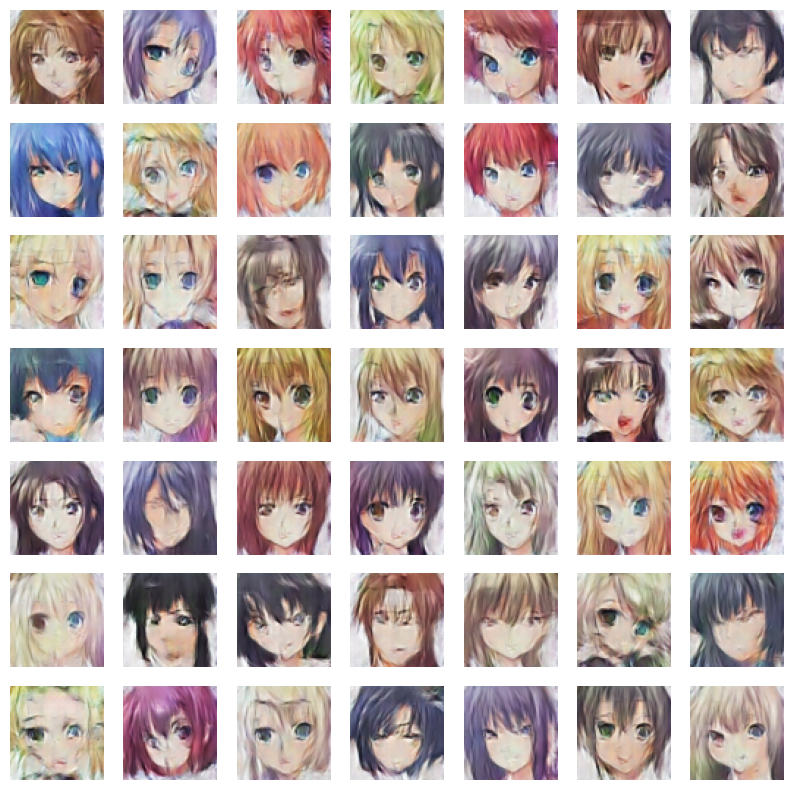

402it [00:35, 11.43it/s]

Looked at 51072 samples

Current generator loss for batch: 3.132514476776123

Current generator accuracy for batch: 0.0078125

Current discriminator loss for batch: 0.3654937744140625

Current discriminator accuracy for batch: 0.9453125


496it [00:43, 11.36it/s]




Average generator loss: 3.90409

Average discriminator loss: 0.54190

Generator accuracy: 0.10955

Discriminator accuracy: 0.88955

Mean of the two accuracies: 0.49955





Saving 21/50 status:'best' checkpoint, current mean accuracy: 0.49955 is better than previous best result: 0.49881

Successfully saved epoch 21 status:best checkpoint!




496it [00:43, 11.36it/s]

496it [00:43, 11.36it/s]


Current epoch: 24/50

-------

Current generated images:


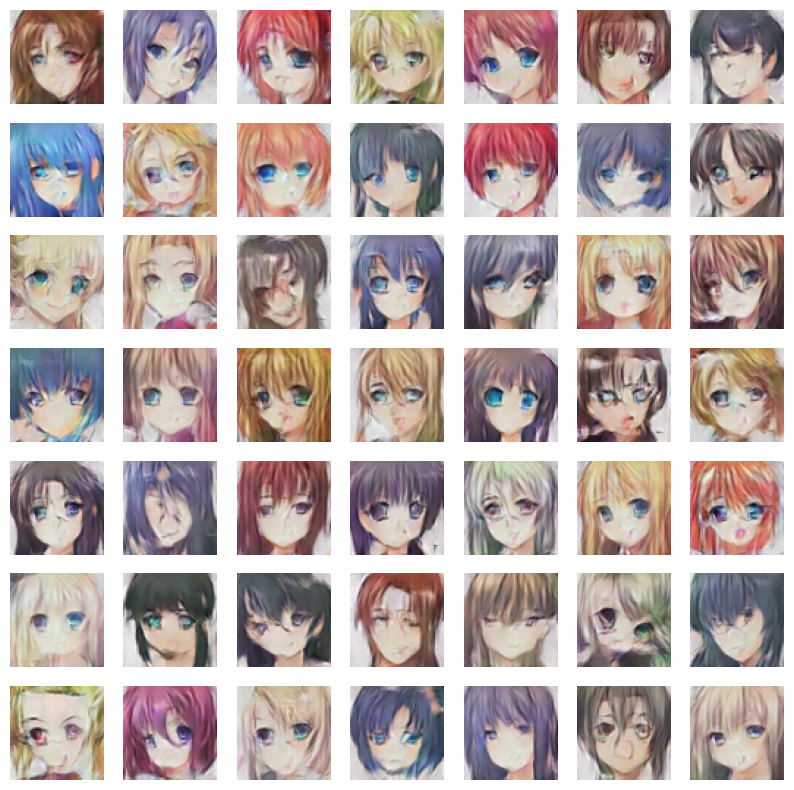

401it [00:35, 11.26it/s]

Looked at 51072 samples

Current generator loss for batch: 3.3288326263427734

Current generator accuracy for batch: 0.0

Current discriminator loss for batch: 1.0317411422729492

Current discriminator accuracy for batch: 0.7578125


496it [00:43, 11.35it/s]




Average generator loss: 3.69485

Average discriminator loss: 0.51892

Generator accuracy: 0.10098

Discriminator accuracy: 0.89728

Mean of the two accuracies: 0.49913





Saving 24/50 status:'last' checkpoint, current mean accuracy: 0.49913

Successfully saved epoch 24 status:last checkpoint!




496it [00:43, 11.32it/s]

496it [00:43, 11.35it/s]


Current epoch: 27/50

-------

Current generated images:


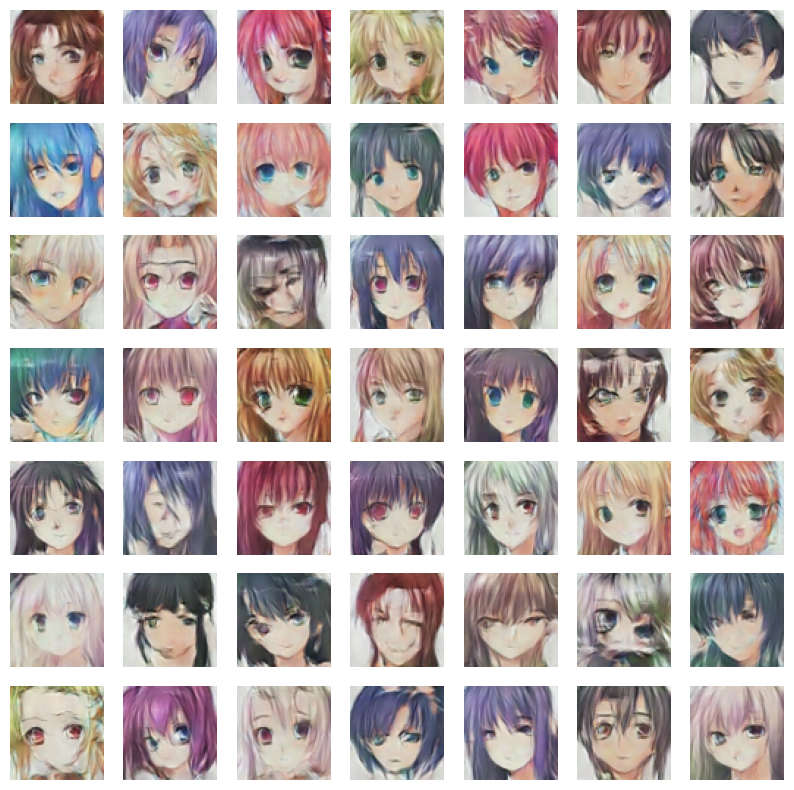

402it [00:35, 11.41it/s]

Looked at 51072 samples

Current generator loss for batch: 4.853734016418457

Current generator accuracy for batch: 0.078125

Current discriminator loss for batch: 0.27331262826919556

Current discriminator accuracy for batch: 0.9609375


496it [00:43, 11.36it/s]




Average generator loss: 3.52333

Average discriminator loss: 0.57795

Generator accuracy: 0.11605

Discriminator accuracy: 0.88258

Mean of the two accuracies: 0.49931





Saving 27/50 status:'last' checkpoint, current mean accuracy: 0.49931

Successfully saved epoch 27 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.33it/s]


Current epoch: 30/50

-------

Current generated images:


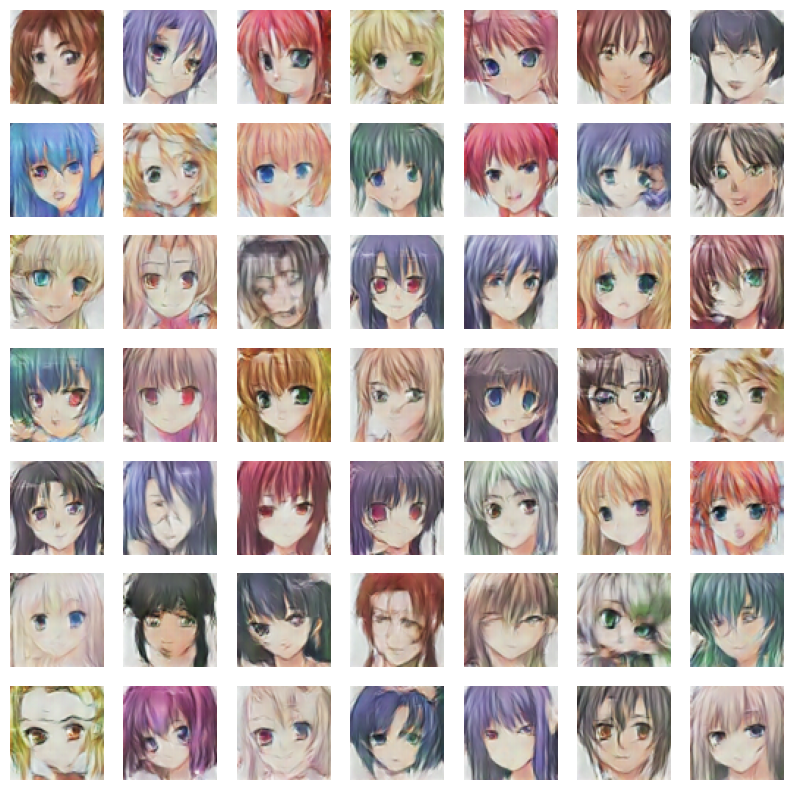

402it [00:35, 11.37it/s]

Looked at 51072 samples

Current generator loss for batch: 6.343315124511719

Current generator accuracy for batch: 0.4921875

Current discriminator loss for batch: 1.0678229331970215

Current discriminator accuracy for batch: 0.75390625


496it [00:43, 11.36it/s]




Average generator loss: 3.44623

Average discriminator loss: 0.57537

Generator accuracy: 0.11440

Discriminator accuracy: 0.88377

Mean of the two accuracies: 0.49908





Saving 30/50 status:'last' checkpoint, current mean accuracy: 0.49908

Successfully saved epoch 30 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.32it/s]


Current epoch: 33/50

-------

Current generated images:


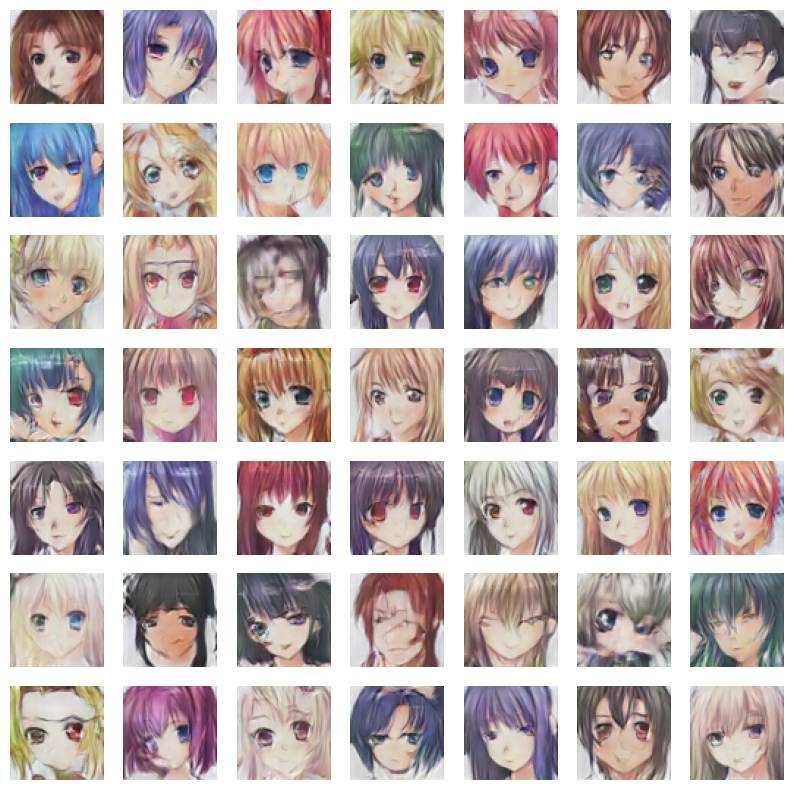

402it [00:35, 11.43it/s]

Looked at 51072 samples

Current generator loss for batch: 2.7144572734832764

Current generator accuracy for batch: 0.0078125

Current discriminator loss for batch: 0.573634684085846

Current discriminator accuracy for batch: 0.84765625


496it [00:43, 11.36it/s]




Average generator loss: 3.48899

Average discriminator loss: 0.54175

Generator accuracy: 0.10925

Discriminator accuracy: 0.88957

Mean of the two accuracies: 0.49941





Saving 33/50 status:'last' checkpoint, current mean accuracy: 0.49941

Successfully saved epoch 33 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.36it/s]


Current epoch: 36/50

-------

Current generated images:


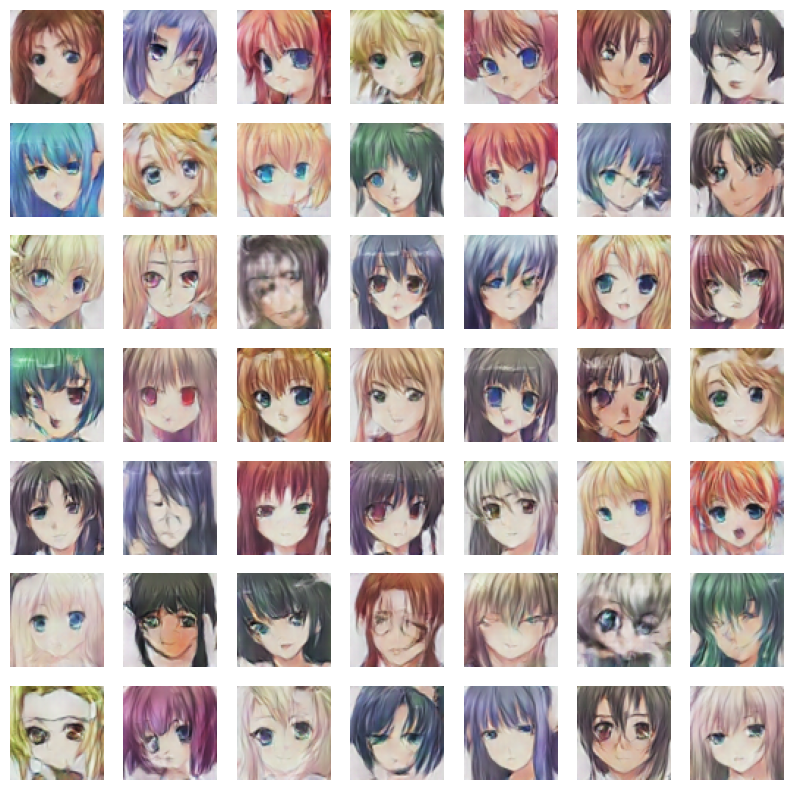

402it [00:35, 11.41it/s]

Looked at 51072 samples

Current generator loss for batch: 3.79160737991333

Current generator accuracy for batch: 0.0625

Current discriminator loss for batch: 0.2503886818885803

Current discriminator accuracy for batch: 0.95703125


496it [00:43, 11.37it/s]




Average generator loss: 3.56234

Average discriminator loss: 0.51381

Generator accuracy: 0.10172

Discriminator accuracy: 0.89704

Mean of the two accuracies: 0.49938





Saving 36/50 status:'last' checkpoint, current mean accuracy: 0.49938

Successfully saved epoch 36 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.35it/s]


Current epoch: 39/50

-------

Current generated images:


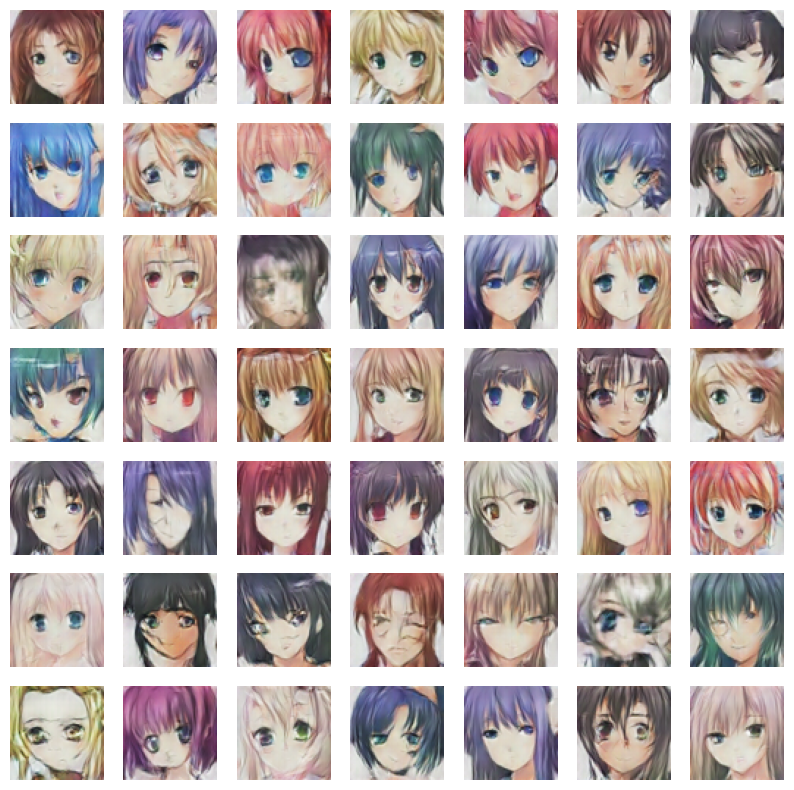

402it [00:35, 11.42it/s]

Looked at 51072 samples

Current generator loss for batch: 7.468026161193848

Current generator accuracy for batch: 0.9296875

Current discriminator loss for batch: 3.3345277309417725

Current discriminator accuracy for batch: 0.53515625


496it [00:43, 11.36it/s]




Average generator loss: 3.53034

Average discriminator loss: 0.51785

Generator accuracy: 0.09449

Discriminator accuracy: 0.90497

Mean of the two accuracies: 0.49973





Saving 39/50 status:'last' checkpoint, current mean accuracy: 0.49973

Successfully saved epoch 39 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.37it/s]


Current epoch: 42/50

-------

Current generated images:


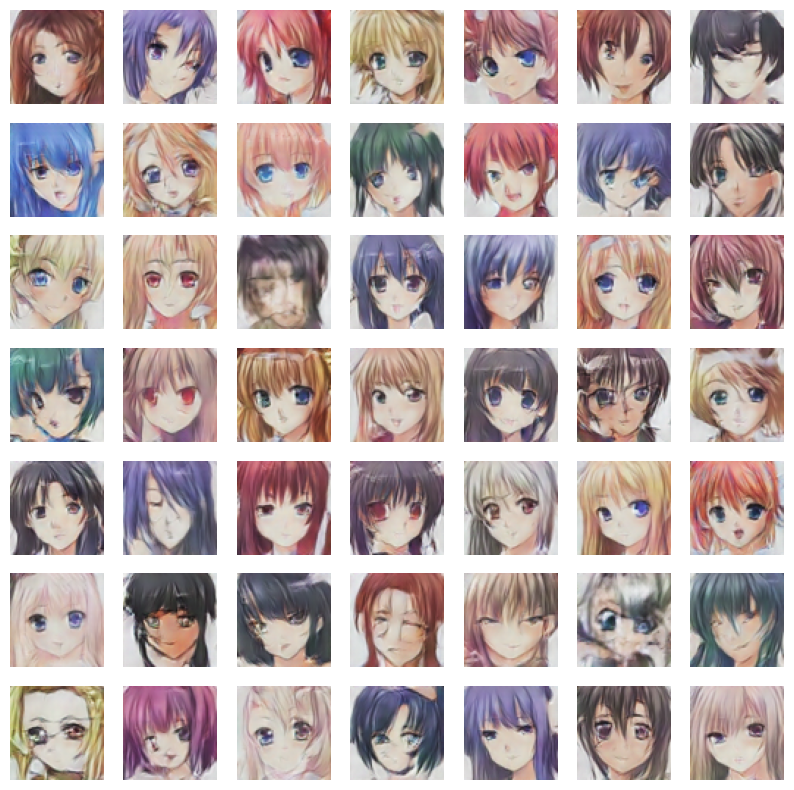

401it [00:35, 11.27it/s]

Looked at 51072 samples

Current generator loss for batch: 6.609320163726807

Current generator accuracy for batch: 0.59375

Current discriminator loss for batch: 1.2691179513931274

Current discriminator accuracy for batch: 0.69921875


496it [00:43, 11.34it/s]




Average generator loss: 3.72896

Average discriminator loss: 0.56034

Generator accuracy: 0.11109

Discriminator accuracy: 0.88711

Mean of the two accuracies: 0.49910





Saving 42/50 status:'last' checkpoint, current mean accuracy: 0.49910

Successfully saved epoch 42 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.32it/s]


Current epoch: 45/50

-------

Current generated images:


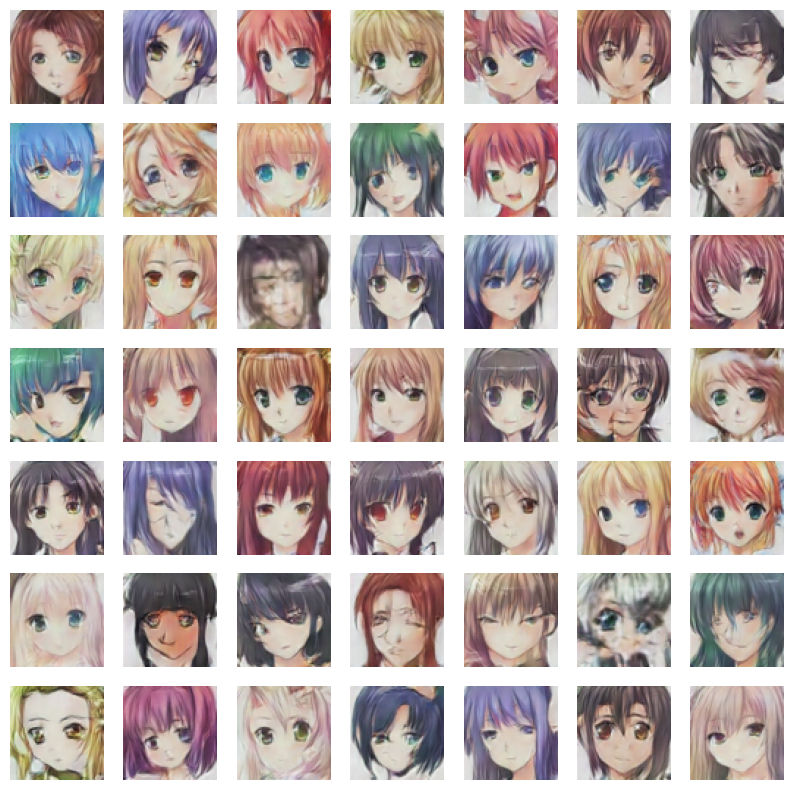

402it [00:35, 11.43it/s]

Looked at 51072 samples

Current generator loss for batch: 2.88824462890625

Current generator accuracy for batch: 0.0234375

Current discriminator loss for batch: 0.3656240999698639

Current discriminator accuracy for batch: 0.93359375


496it [00:43, 11.36it/s]




Average generator loss: 3.62163

Average discriminator loss: 0.52952

Generator accuracy: 0.09997

Discriminator accuracy: 0.89930

Mean of the two accuracies: 0.49963





Saving 45/50 status:'last' checkpoint, current mean accuracy: 0.49963

Successfully saved epoch 45 status:last checkpoint!




496it [00:43, 11.36it/s]

496it [00:43, 11.37it/s]


Current epoch: 48/50

-------

Current generated images:


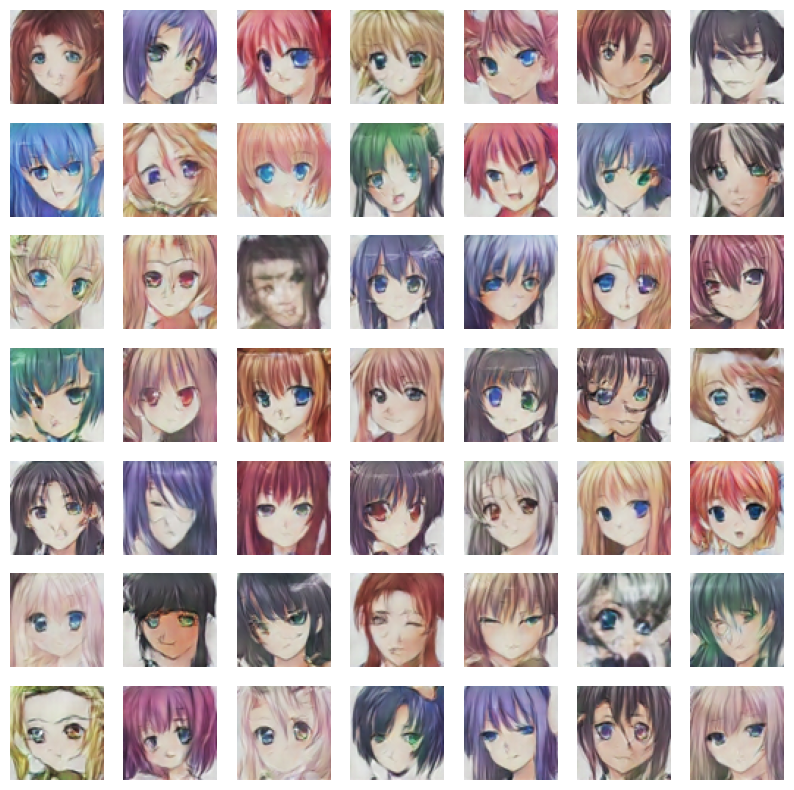

402it [00:35, 11.39it/s]

Looked at 51072 samples

Current generator loss for batch: 4.532630920410156

Current generator accuracy for batch: 0.140625

Current discriminator loss for batch: 0.44522714614868164

Current discriminator accuracy for batch: 0.91015625


496it [00:43, 11.36it/s]




Average generator loss: 3.81924

Average discriminator loss: 0.50969

Generator accuracy: 0.09846

Discriminator accuracy: 0.90125

Mean of the two accuracies: 0.49985





Saving 48/50 status:'last' checkpoint, current mean accuracy: 0.49985

Successfully saved epoch 48 status:last checkpoint!




496it [00:43, 11.37it/s]

496it [00:43, 11.37it/s]


In [13]:
# train for 50 epochs
GAN.train_validate_cycle(epochs=50, cycle_epoch=3)

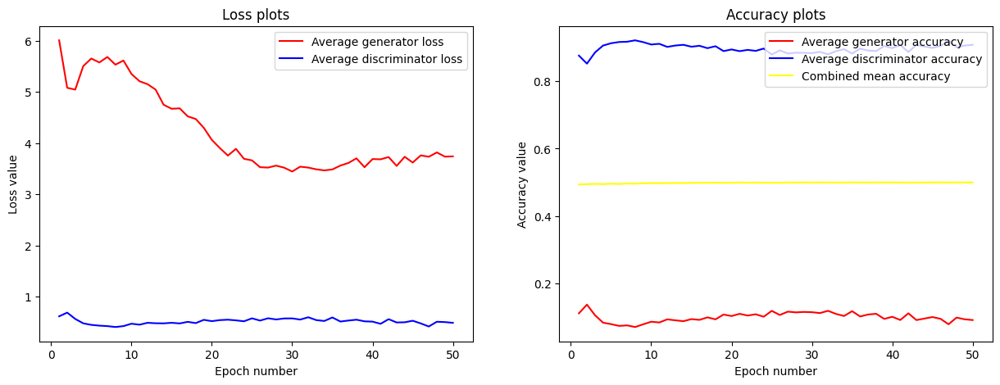

In [14]:
GAN.plot_loss_acc()

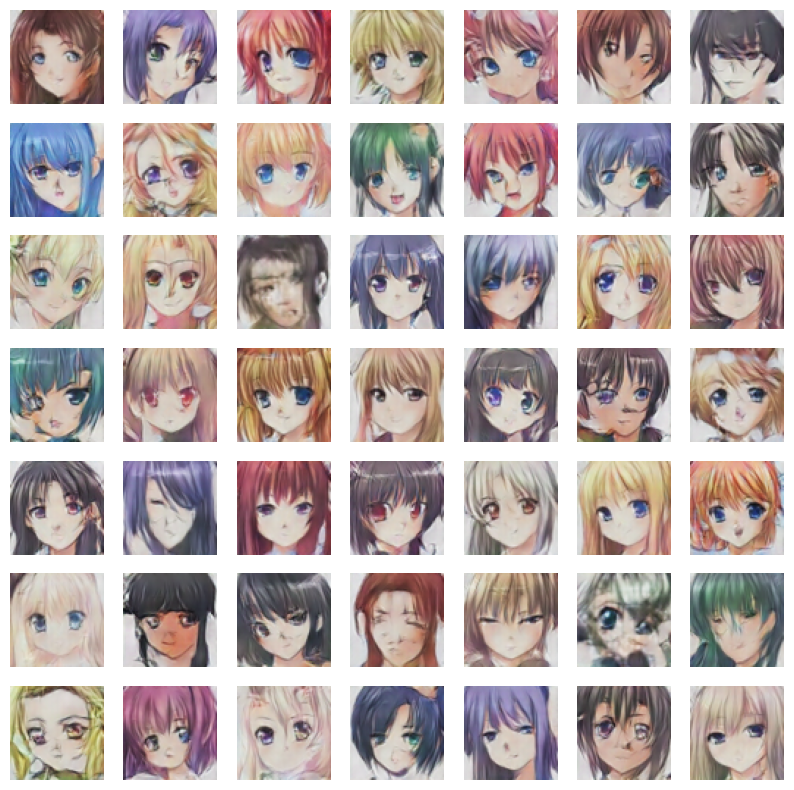

In [15]:
GAN.display_control_output() # epoch 50 checkpoint result

# Interpolation between two faces using GAN model

In [89]:
def display_smooth_transition(generator, rows=5, cols=10, seed=10, gen_vec=None):
    """
    Generates and displays a 5x10 grid of images with smooth transitions.
    """
    generator.eval()
    # Set the random seed for torch.randn
    torch.manual_seed(seed)
    
    if gen_vec is not None:
        starting_inputs = torch.reshape(gen_vec, (rows, 2, -1))
    else:
        # Generate rows starting random inputs for the generator
        starting_inputs = torch.randn(rows, 2, generator.latent_dim).to(device)

    # Create a figure for the grid of images
    fig = plt.figure(figsize=(2* cols, 2* rows))
    
    with torch.no_grad():
        # For each row
        for row in range(rows):
            # Get the starting inputs for this row
            starting_input1, starting_input2 = starting_inputs[row]
            # For each column
            for col in range(cols):
                # Interpolate between the two starting inputs
                alpha = col / (cols-1)  # alpha ranges from 0 to 1
                interpolated_input = (1 - alpha) * starting_input1 + alpha * starting_input2
                # Generate an image using the interpolated input
                img = generator(interpolated_input.unsqueeze(dim=0)).detach().to("cpu")
                # Add the image to the grid
                fig.add_subplot(rows, cols, row * cols + col + 1)
                plt.imshow((img[0] * std_trn[:, None, None] + mean_trn[:, None, None]).permute(1,2,0))
                plt.axis(False)
        # Adjust subplot parameters to remove space between rows
        plt.subplots_adjust(wspace=0, hspace=0)
        # Display the grid of images
        plt.show()

In [13]:
# Create Training model
GAN = AdversaryTraining(generator, discriminator, optimizer_G, optimizer_D, adversarial_loss,
                       train_loader, device, checkpoint_dir="/kaggle/input/dcgan_data/last_cpt")

Loading AdversaryTraining model from checkpoint trained for 50 epochs...
Model successfully created! Current start_epoch=51


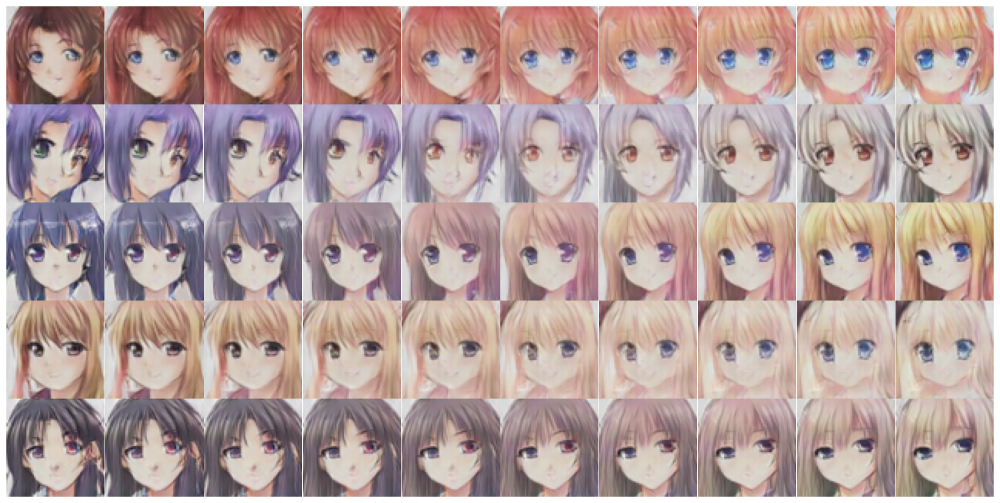

In [90]:
display_smooth_transition(GAN.generator, rows=5, cols=10, seed=10, gen_vec=GAN.control_input[[0,9,1,32,17,33,24,35,28,48]])

# Choosing faces for latent vector transformations

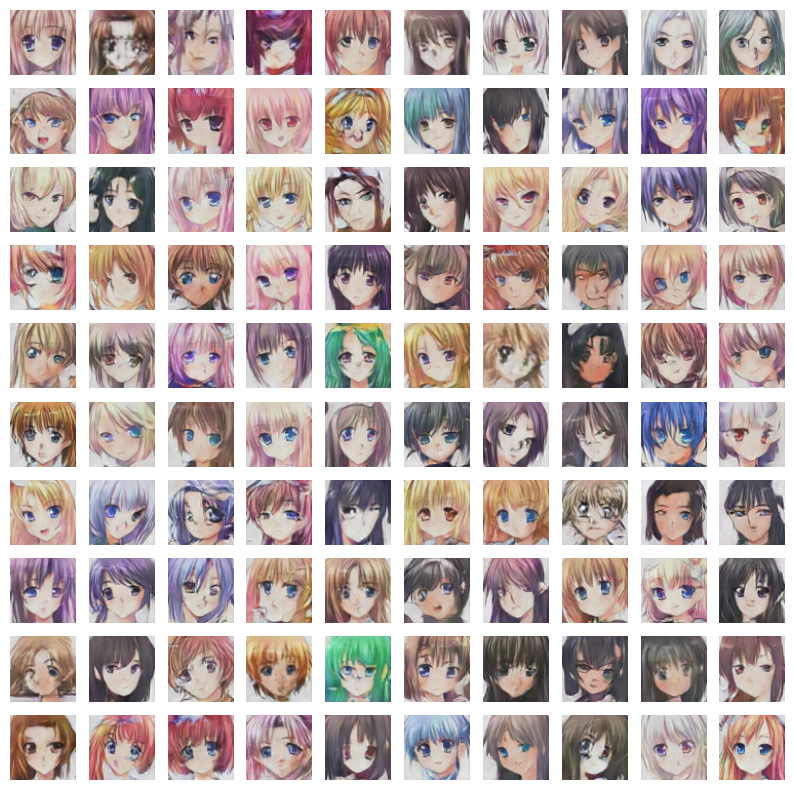

In [94]:
def display_random_outputs(generator, grid_size=10, seed=21):
    # Set the random seed for torch.randn
    torch.manual_seed(seed)
    rand_inputs = torch.randn(grid_size**2, generator.latent_dim).to(device)
    generated_images = generator(rand_inputs).detach().to("cpu")

    # Show images and labels in a grid grid_size**2
    fig = plt.figure(figsize=(10, 10))

    for i in range(0, grid_size**2):
        img = generated_images[i]
        fig.add_subplot(grid_size, grid_size, i + 1)
        plt.imshow((img * std_trn[:, None, None] + mean_trn[:, None, None]).permute(1,2,0))
        plt.axis(False)

    plt.show()
    return rand_inputs
latent_inputs = display_random_outputs(GAN.generator)

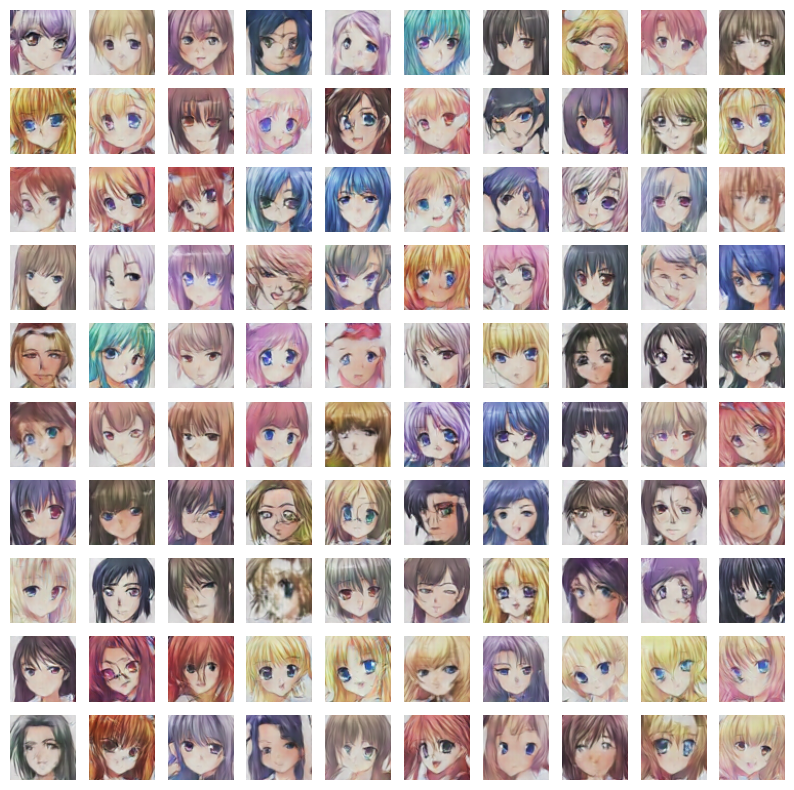

In [95]:
latent_inputs_two = display_random_outputs(GAN.generator, seed=22)

# Visualization of chosen faces
### First row: faces with blonde hair looking to the right
### Second row: faces with blonde hair looking to the left
### Third row: faces with dark hair looking to the left

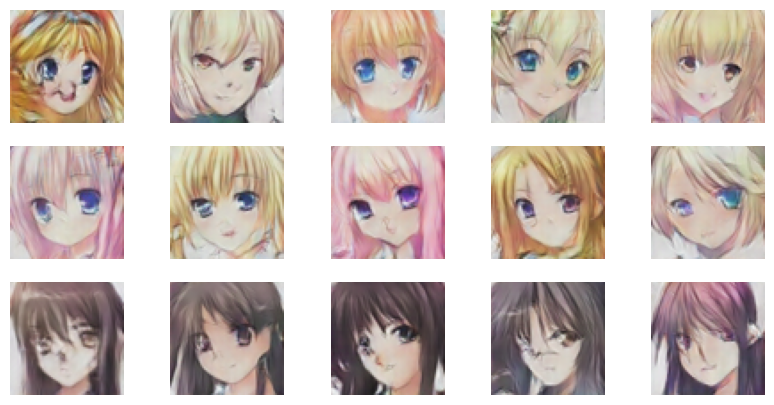

In [101]:
light_hair_face_right = torch.vstack((latent_inputs[[14, 20]], GAN.control_input[[9,14]], latent_inputs_two[-1]))
light_hair_face_left = latent_inputs[[22, 23, 33, 45, 51]]
dark_hair_face_left = latent_inputs[[5, 7, 25, 57, 76]]
mean_dark_hair_face_right = torch.mean(light_hair_face_right, dim=0) - torch.mean(light_hair_face_left, dim=0) + torch.mean(dark_hair_face_left, dim=0)
fig = plt.figure(figsize=(10, 5))
all_faces_latent_vectors = torch.vstack((light_hair_face_right, light_hair_face_left, dark_hair_face_left))
generated_images = generator(all_faces_latent_vectors).detach().to("cpu")
for i in range(0, 15):
    img = generated_images[i]
    fig.add_subplot(3, 5, i + 1)
    plt.imshow((img * std_trn[:, None, None] + mean_trn[:, None, None]).permute(1,2,0))
    plt.axis(False)

## Mean of each row taken, then new_latent_vec = mean_row_1 - mean_row_2 + mean_row_3 is found.
## Expected result: face with a dark hair that is looking to the right

(-0.5, 63.5, 63.5, -0.5)

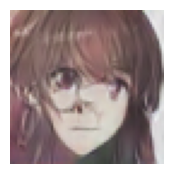

In [104]:
generated_image = generator(mean_dark_hair_face_right.unsqueeze(dim=0)).detach().to("cpu")
fig = plt.figure(figsize=(2, 2))
plt.imshow((generated_image[0] * std_trn[:, None, None] + mean_trn[:, None, None]).permute(1,2,0))
plt.axis(False)

# Conclusions

### As we see we got pretty decent results in the end, some of the faces can be easilly taken for real. After doing the work it becomes clear that GAN is very sensitive to hyperparameters. The smallest deviations lead to a significant deterioration of the results. Most often, the model begins to produce very similar results for any input noise, and moreover, very low quality. As we can see it is really hard to access quantative quality of the GAN model judjing by loss and accuracy. This is because low loss (or high accuracy) of generator can be due to the fact of worse discriminator results and vice versa - low loss (or high accuracy) of discriminator can be due to the fact of good generator results.
### As we can see latent space of the GAN can be treated continuous in some sense, as the model is capable of generating good quality faces by finding a convex sum of two latent vectors, that were used to create other good quality faces. We can also see that operations in GAN latent space have a close resemblance to NLP models latent space, as the operation between latent vectors like light_hair_right_looking - light_hair_left_looking + dark_hair_right_looking =(approx.) dark_hair_right_looking works in a similar way to the operations between terms in an embedding form like king - man + woman =(approx.) queen.